In [1]:
# Install the required libraries
#SAM
!pip install git+https://github.com/facebookresearch/segment-anything.git
#Transformers
!pip install -q git+https://github.com/huggingface/transformers.git
#Datasets to prepare data and monai if you want to use special loss functions
!pip install datasets
!pip install -q monai
#Patchify to divide large images into smaller patches for training. (Not necessary for smaller images)
!pip install patchify

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-gu2ux2fx
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-gu2ux2fx
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36590 sha256=565ce4641c9326924dbfd0178f563907e87882fe588376f276b98317908a99fa
  Stored in directory: /tmp/pip-ephem-wheel-cache-zeem7s6n/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.5/510.5 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import os
from patchify import patchify  #Only to handle large images
import random
from scipy import ndimage
from google.colab import drive
import cv2
from PIL import Image


In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Path to the folder containing images and masks
images_folder_path = "/content/drive/MyDrive/MRI Images/ab_image_new"
masks_folder_path = "/content/drive/MyDrive/MRI Images/white-masks"

# Desired patch size for smaller images and step size ==> when the image is too big, it divides into smaller "patches" for easier processing
patch_size = 256
step = 256

In [5]:
def patchify(image, patch_shape, step):
    patches = []
    for i in range(0, image.shape[0] - patch_shape[0] + 1, step):
        for j in range(0, image.shape[1] - patch_shape[1] + 1, step):
            patch = image[i:i+patch_shape[0], j:j+patch_shape[1]]
            patches.append(patch)
    return np.array(patches)

def load_images_and_masks_from_folder(images_folder_path, masks_folder_path):
    image_files = os.listdir(images_folder_path)
    mask_files = os.listdir(masks_folder_path)

    # Sort the file lists to ensure images and masks are in the same order
    image_files.sort()
    mask_files.sort()

    images = []
    masks = []

    for img_file, mask_file in zip(image_files, mask_files):
        if img_file.endswith(".jpg") or img_file.endswith(".png"):
            image_path = os.path.join(images_folder_path, img_file)
            mask_path = os.path.join(masks_folder_path, mask_file)

            # Load and resize image
            image = cv2.imread(image_path)
            image = resize_image(image, 1024, 768)

            # Load and resize mask
            mask = cv2.imread(mask_path)
            mask = resize_image(mask, 1024, 768)

            images.append(image)
            masks.append(mask)

    return images, masks

# The function below is to be used when there is uncertainity in the dimensions of all the images within a folder
def resize_image(image, width, height):
    # Resize using OpenCV
    resized_image = cv2.resize(image, (width, height))
    # Convert back to PIL image
    resized_image_pil = Image.fromarray(resized_image)
    return resized_image_pil


# Now images and masks contain correctly paired image and mask data



def visualize_images_and_masks(images, masks, num_samples=5):
    num_samples = min(num_samples, len(images), len(masks))
    fig, axes = plt.subplots(num_samples, 2, figsize=(10, num_samples * 5))

    for i in range(num_samples):
        axes[i, 0].imshow(images[i], cmap='gray')
        axes[i, 0].set_title("Image {}".format(i+1))
        axes[i, 0].axis('off')

        axes[i, 1].imshow(masks[i], cmap='gray')
        axes[i, 1].set_title("Mask {}".format(i+1))
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

In [6]:
# Load images and masks
images, masks = load_images_and_masks_from_folder(images_folder_path, masks_folder_path)

# Resize images to 1024x768 resolution as certain images are 1024x768 but others are 2048x2048
# resized_images = [resize_image(image, 1024, 768) for image in images]
# resized_masks = [resize_image(mask, 1024, 768) for mask in masks]

In [7]:
print(images[0].size)
print(masks[0].size)
# print(resized_images[0].shape)

(1024, 768)
(1024, 768)


In [ ]:
# all_img_patches = []
# for image in images:
#     patches_img = patchify(image, (patch_size, patch_size), step=step)

#     for i in range(patches_img.shape[0]):
#         for j in range(patches_img.shape[1]):
#             single_patch_img = patches_img[i,j,:,:]
#             all_img_patches.append(single_patch_img)

# images_1 = np.array(all_img_patches)

# all_mask_patches = []
# for mask in masks:
#     patches_mask = patchify(mask, (patch_size, patch_size), step=step)

#     for i in range(patches_mask.shape[0]):
#         for j in range(patches_mask.shape[1]):
#             single_patch_mask = patches_mask[i,j,:,:]
#             single_patch_mask = (single_patch_mask / 255.).astype(np.uint8)
#             all_mask_patches.append(single_patch_mask)

# masks_1 = np.array(all_mask_patches)

# PATCHIFY CAUSING ERRORS --> SKIPPING PATCHIFY PROCESS OF BREAKING LARGE IMAGES INTO SMALLER CHUNKS

AttributeError: shape

In [ ]:
images_1.shape

NameError: name 'images_1' is not defined

In [8]:
# WORKAROUND CODE:

# Function to load images from a folder
def load_images_from_folder(folder_path):
    images = []
    for filename in sorted(os.listdir(folder_path)):
        if filename.lower().endswith((".jpg", ".png")):
            image_path = os.path.join(folder_path, filename)
            image = cv2.imread(image_path)
            resized_image = resize_image(image, 256, 256)
            images.append(resized_image)
    return images

# Function to resize an image
def resize_image(image, width, height):
    resized_image = cv2.resize(image, (width, height))
    return resized_image

# Load images and masks
images = load_images_from_folder(images_folder_path)
masks = load_images_from_folder(masks_folder_path)

# Check the size of the first image and mask after resizing
print("Image shape after resizing:", images[0].shape)
print("Mask shape after resizing:", masks[0].shape)


Image shape after resizing: (256, 256, 3)
Mask shape after resizing: (256, 256, 3)


In [9]:
#PATCHIFY CODE BELOW TO REMOVE PURE BLACK MASKS

# # Create a list to store the indices of non-empty masks
# valid_indices = [i for i, mask in enumerate(masks) if mask.max() != 0]
# # Filter the image and mask arrays to keep only the non-empty pairs
# filtered_images = images_1[valid_indices]
# filtered_masks = masks_1[valid_indices]
# print("Image shape:", filtered_images.shape)  # e.g., (num_frames, height, width, num_channels)
# print("Mask shape:", filtered_masks.shape)

In [10]:

# Convert images to numpy array
images_array = np.array([np.array(image) for image in images])

# Convert masks to numpy array
masks_array = np.array([np.array(mask) for mask in masks])


# Remove the third dimension (if present) from the images and masks arrays
images_array = images_array[..., :3]  # Select only the first three channels
masks_array = masks_array[..., 0]    # Select only the first channel (assuming masks are binary or grayscale)

# Check the shapes of the arrays
print("Images array shape:", images_array.shape)
print("Masks array shape:", masks_array.shape)

# Check the shapes of the arrays
print("Images array shape:", images_array.shape)
print("Masks array shape:", masks_array.shape)


Images array shape: (125, 256, 256, 3)
Masks array shape: (125, 256, 256)
Images array shape: (125, 256, 256, 3)
Masks array shape: (125, 256, 256)


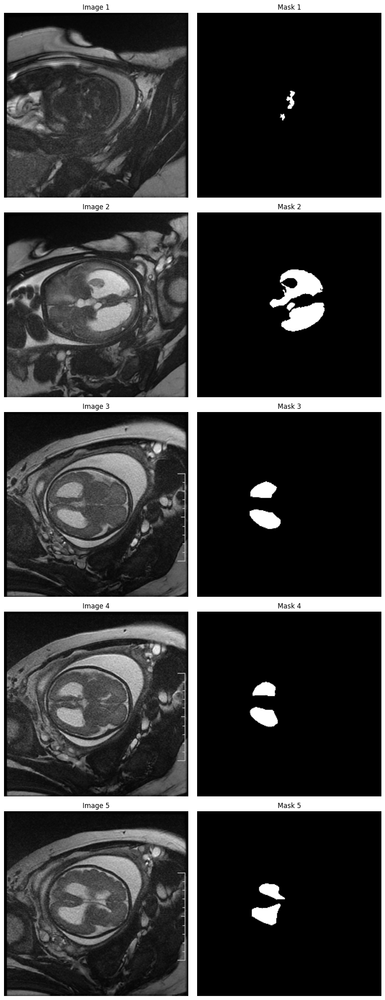

In [11]:
visualize_images_and_masks(images_array, masks_array, num_samples=5)


In [12]:
from datasets import Dataset
from PIL import Image

# Convert the NumPy arrays to Pillow images and store them in a dictionary
dataset_dict = {
    "image": [Image.fromarray(img) for img in images_array],
    "label": [Image.fromarray(mask) for mask in masks_array],
}

# Create the dataset using the datasets.Dataset class
dataset = Dataset.from_dict(dataset_dict)

In [13]:
dataset

Dataset({
    features: ['image', 'label'],
    num_rows: 125
})

In [14]:
def visualize_dataset(dataset, num_samples=5):
    num_samples = min(num_samples, len(dataset))  # Ensure num_samples does not exceed the number of images
    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 5*num_samples))

    for i in range(num_samples):
        # Get the image and mask for the current sample
        sample = dataset[i]
        image = sample["image"]
        mask = sample["label"]

        # Plot the image on the left subplot
        axes[i, 0].imshow(image, cmap='gray')  # Assuming the image is grayscale
        axes[i, 0].set_title(f"Image {i+1}")
        axes[i, 0].axis('off')

        # Plot the mask on the right subplot
        axes[i, 1].imshow(mask, cmap='gray')  # Assuming the mask is grayscale
        axes[i, 1].set_title(f"Mask {i+1}")
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize the dataset
visualize_dataset(dataset,dataset.num_rows)

In [15]:
#Original function:

# Get bounding boxes from mask.
# def get_bounding_box(ground_truth_map):
#   # get bounding box from mask
#   y_indices, x_indices = np.where(ground_truth_map > 0)
#   x_min, x_max = np.min(x_indices), np.max(x_indices)
#   y_min, y_max = np.min(y_indices), np.max(y_indices)
#   # add perturbation to bounding box coordinates
#   H, W = ground_truth_map.shape
#   x_min = max(0, x_min - np.random.randint(0, 20))
#   x_max = min(W, x_max + np.random.randint(0, 20))
#   y_min = max(0, y_min - np.random.randint(0, 20))
#   y_max = min(H, y_max + np.random.randint(0, 20))
#   bbox = [x_min, y_min, x_max, y_max]

#   return bbox

# This function orginally had only 2 dimension handling capablity, it has been modified to handle more than 2 dimesions
def get_bounding_box(ground_truth_map):
    # get bounding box from mask
    non_zero_indices = np.where(ground_truth_map > 0)
    if len(non_zero_indices) == 0:
        return [0, 0, 0, 0]  # Return default values if mask is empty
    x_indices = non_zero_indices[-1]
    y_indices = non_zero_indices[-2]
    x_min, x_max = np.min(x_indices), np.max(x_indices)
    y_min, y_max = np.min(y_indices), np.max(y_indices)

    # add perturbation to bounding box coordinates
    H, W = ground_truth_map.shape[-2:]
    x_min = max(0, x_min - np.random.randint(0, 20))
    x_max = min(W, x_max + np.random.randint(0, 20))
    y_min = max(0, y_min - np.random.randint(0, 20))
    y_max = min(H, y_max + np.random.randint(0, 20))
    bbox = [x_min, y_min, x_max, y_max]

    return bbox


In [23]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_bounding_box(mask, bbox):
    """
    Visualize the bounding box outline on the mask image.

    Args:
    - mask (numpy.ndarray): The mask image.
    - bbox (list): The bounding box coordinates [x_min, y_min, x_max, y_max].
    """
    # Plot the mask image
    plt.imshow(mask, cmap='gray')
    plt.title("Mask with Bounding Box")

    # Extract bounding box coordinates
    x_min, y_min, x_max, y_max = bbox

    # Create a Rectangle patch
    rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                             linewidth=1, edgecolor='r', facecolor='none')

    # Add the rectangle patch to the current axis
    plt.gca().add_patch(rect)

    # Show plot
    plt.axis('off')
    plt.show()

# Example usage:
# Assuming `mask` is the mask image and `bbox` is the bounding box coordinates
# visualize_bounding_box(mask, bbox)


Bounding box coordinates: [67, 82, 124, 175]


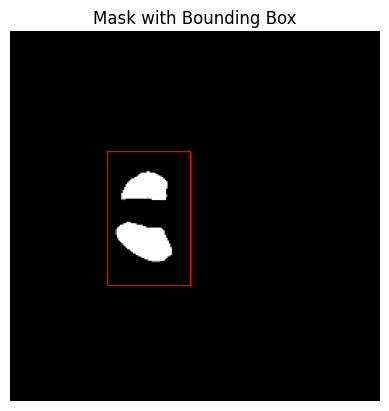

In [24]:
import numpy as np

# Example usage of get_bounding_box function
# Assuming `ground_truth_map` is the mask image
bbox = get_bounding_box(masks_array[3])
print("Bounding box coordinates:", bbox)

visualize_bounding_box(masks_array[3],bbox)


In [ ]:
from torch.utils.data import Dataset

class SAMDataset(Dataset):
  """
  This class is used to create a dataset that serves input images and masks.
  It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
  """
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["label"])

    # get bounding box prompt
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image and prompt for the model
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")

    # remove batch dimension which the processor adds by default
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation
    inputs["ground_truth_mask"] = ground_truth_mask

    return inputs

In [ ]:
# Initialize the processor
from transformers import SamProcessor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

In [ ]:
# Create an instance of the SAMDataset
train_dataset = SAMDataset(dataset=dataset, processor=processor)

In [ ]:
print(train_dataset[0])

{'pixel_values': tensor([[[-2.1179, -2.1179, -2.1179,  ..., -2.0837, -2.0837, -2.0837],
         [-2.1179, -2.1179, -2.1179,  ..., -2.0837, -2.0837, -2.0837],
         [-2.1179, -2.1179, -2.1179,  ..., -2.0837, -2.0837, -2.0837],
         ...,
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179]],

        [[-2.0357, -2.0357, -2.0357,  ..., -2.0007, -2.0007, -2.0007],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0007, -2.0007, -2.0007],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0007, -2.0007, -2.0007],
         ...,
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357]],

        [[-1.8044, -1.8044, -1.8044,  ..., -1.7696, -1.7696, -1.7696],
         [-1.8044, -1.8044, 

In [ ]:
example = train_dataset[0]
for k,v in example.items():
  print(k,v.shape)


pixel_values torch.Size([3, 1024, 1024])
original_sizes torch.Size([2])
reshaped_input_sizes torch.Size([2])
input_boxes torch.Size([1, 4])
ground_truth_mask (256, 256)


In [ ]:
# Create a DataLoader instance for the training dataset
from torch.utils.data import DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True, drop_last=False)

In [ ]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [ ]:
batch["ground_truth_mask"].shape

torch.Size([2, 256, 256])

In [ ]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/375M [00:00<?, ?B/s]

In [ ]:
from torch.optim import Adam
import monai
# Initialize the optimizer and the loss function
optimizer = Adam(model.mask_decoder.parameters(), lr=1e-5, weight_decay=0)
#Try DiceFocalLoss, FocalLoss, DiceCELoss
seg_loss = monai.losses.DiceCELoss(sigmoid=True, squared_pred=True, reduction='mean')

In [ ]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize

#Training loop
num_epochs = 1

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()
for epoch in range(num_epochs):
    epoch_losses = []
    for batch in tqdm(train_dataloader):
      # forward pass
      inputs = {
            "pixel_values": batch["pixel_values"].to(device),
            "input_boxes": batch["input_boxes"].to(device)
        }
      outputs = model(**inputs, multimask_output=False)
      # compute loss
      predicted_masks = outputs.pred_masks.squeeze(1)
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)
      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

      # backward pass (compute gradients of parameters w.r.t. loss)
      optimizer.zero_grad()
      loss.backward()

      # optimize
      optimizer.step()
      epoch_losses.append(loss.item())

    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {mean(epoch_losses)}')

100%|██████████| 63/63 [1:12:55<00:00, 69.45s/it]

EPOCH: 0
Mean loss: -379.6886159238361


In [ ]:
torch.save(model.state_dict(), "/content/drive/MyDrive/ColabNotebooks/models/SAM_model_checkpoint.pth")

In [ ]:
from transformers import SamModel, SamConfig, SamProcessor
import torch

In [ ]:
# Load the model configuration
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

# Create an instance of the model architecture with the loaded configuration
my_model = SamModel(config=model_config)
#Update the model by loading the weights from saved file.
my_model.load_state_dict(torch.load("/content/drive/MyDrive/ColabNotebooks/models/SAM_model_checkpoint.pth"))

<All keys matched successfully>

In [ ]:
# set the device to cuda if available, otherwise use cpu
device = "cuda" if torch.cuda.is_available() else "cpu"
my_model.to(device)

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

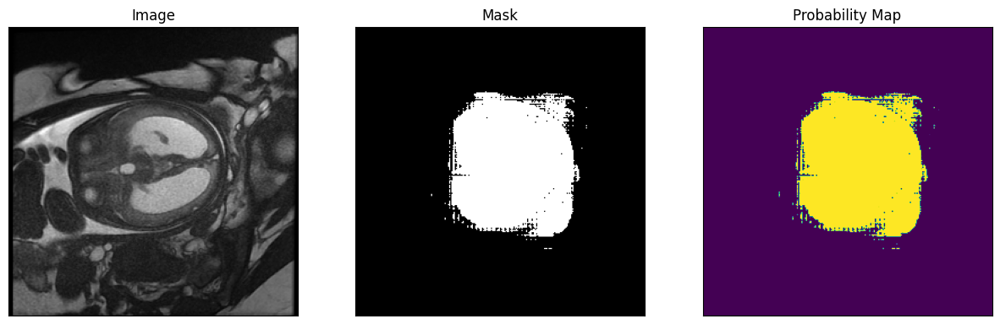

In [ ]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

# let's take a random training example
idx = random.randint(0, images_array.shape[0]-1)

# load image
test_image = dataset[idx]["image"]

# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(dataset[idx]["label"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")

# Move the input tensor to the GPU if it's not already there
inputs = {k: v.to(device) for k, v in inputs.items()}

my_model.eval()

# forward pass
with torch.no_grad():
    outputs = my_model(**inputs, multimask_output=False)

# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.9).astype(np.uint8)


fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(test_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg_prob)  # Assuming the second image is grayscale
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()